# Walmart Store Sales Forecasting

### Use historical markdown data to predict store sales

* The main objective of our model is to predict sales of store in a week.
* Mean Absolute Error(MAE) is considered as a Performance metric.
* We are provided with historical sales data for 45 Walmart stores located in different regions. Each store contains a number of departments, and the task is to predictthe department-wide sales for each store.

### Importing Libraries

In [1]:
#required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import pyplot
import seaborn as sns


import warnings
warnings.filterwarnings('ignore')

#machine learning models libraries
from sklearn.linear_model import SGDRegressor
from sklearn.linear_model import RidgeCV
import lightgbm as lgb
from sklearn.ensemble import RandomForestRegressor 
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import LinearRegression

#preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_absolute_error as mae

#data related libraries
from datetime import date
import datetime

### Loading Datasets

In [2]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
stores = pd.read_csv("stores.csv")
features = pd.read_csv("features.csv")
sample_submission = pd.read_csv("sampleSubmission.csv")

In [3]:
print("-----------------------------FEATURES---------------------\n")
print(features.head())
print("-----------------------------STORES-----------------------\n")
print(stores.head())
print("-----------------------------TRAIN------------------------\n")
print(train.head())
print("-----------------------------TEST-------------------------\n")
print(test.head())
print("-------------------------SUBMISSION SAMPLE----------------\n")
print(sample_submission.head())

-----------------------------FEATURES---------------------

   Store        Date  Temperature  Fuel_Price  MarkDown1  MarkDown2  \
0      1  2010-02-05        42.31       2.572        NaN        NaN   
1      1  2010-02-12        38.51       2.548        NaN        NaN   
2      1  2010-02-19        39.93       2.514        NaN        NaN   
3      1  2010-02-26        46.63       2.561        NaN        NaN   
4      1  2010-03-05        46.50       2.625        NaN        NaN   

   MarkDown3  MarkDown4  MarkDown5         CPI  Unemployment  IsHoliday  
0        NaN        NaN        NaN  211.096358         8.106      False  
1        NaN        NaN        NaN  211.242170         8.106       True  
2        NaN        NaN        NaN  211.289143         8.106      False  
3        NaN        NaN        NaN  211.319643         8.106      False  
4        NaN        NaN        NaN  211.350143         8.106      False  
-----------------------------STORES-----------------------

   Store 

We can see that the test dataset don't contain the features included in the train dataset, taking into consideration that these features (Temperature, Fuel price, MarkDowns, CPI and Unemployment) cannot be used in the test dataset due to their high dependences on the date, so it will be a good idea to delete them. but before that, we will make sure that these features don't provide any information on the target 'Weekly_Sales'.

In [69]:
# Finding the number of rowns and columns in dataframe
features.shape, train.shape, stores.shape, test.shape,sample_submission.shape

((8190, 12), (420212, 20), (45, 3), (115064, 19), (115064, 2))

In [5]:
# Some basic information of differnt column's data type of dataframe
print("<-----------------------------FEATURES--------------------->\n")
print(features.dtypes)
print("<----------------------------TRAIN DATA--------------------->\n")
print(train.dtypes)
print("<-----------------------------STORE DATA-------------------->\n")
print(stores.dtypes)
print("<-------------------------------TEST DATA------------------->\n")
print(test.dtypes)

<-----------------------------FEATURES--------------------->

Store             int64
Date             object
Temperature     float64
Fuel_Price      float64
MarkDown1       float64
MarkDown2       float64
MarkDown3       float64
MarkDown4       float64
MarkDown5       float64
CPI             float64
Unemployment    float64
IsHoliday          bool
dtype: object
<----------------------------TRAIN DATA--------------------->

Store             int64
Dept              int64
Date             object
Weekly_Sales    float64
IsHoliday          bool
dtype: object
<-----------------------------STORE DATA-------------------->

Store     int64
Type     object
Size      int64
dtype: object
<-------------------------------TEST DATA------------------->

Store         int64
Dept          int64
Date         object
IsHoliday      bool
dtype: object


### Prepare Dataset for Training

#### Data Cleaning

Let's start by cleaning the data of both datasets. We will see if they have missing values, duplicates and see if eliminate them if thats the case.

Very important to take into account that both datasets are going to merge. Therefore, they must have one key column that has the same values. Hence, We will also see if the values are consistent in both datasets.

In [6]:
feature_store = features.merge(stores, how='inner', on = "Store")

In [7]:
train = train.merge(feature_store, how='inner', on=['Store','Date','IsHoliday'])

In [8]:
test = test.merge(feature_store, how='inner', on=['Store','Date','IsHoliday'])

Another useful step is to facilate the acces to the 'Date' attribute by splitting it into its componenents (i.e. Year, Month and week,day).

In [9]:
train = train.copy()
test = test.copy()

In [10]:
train['Date'] = pd.to_datetime(train['Date'])
train['Year'] = pd.to_datetime(train['Date']).dt.year
train['Month'] = pd.to_datetime(train['Date']).dt.month
train['Week'] = pd.to_datetime(train['Date']).dt.week
train['Day'] = pd.to_datetime(train['Date']).dt.day
train.replace({'A': 1, 'B': 2,'C':3},inplace=True)

test['Date'] = pd.to_datetime(test['Date'])
test['Year'] = pd.to_datetime(test['Date']).dt.year
test['Month'] = pd.to_datetime(test['Date']).dt.month
test['Week'] = pd.to_datetime(test['Date']).dt.week
test['Day'] = pd.to_datetime(test['Date']).dt.day
test.replace({'A': 1, 'B': 2,'C':3},inplace=True)

In [11]:
print("-------------------------TRAIN DATA------------------------\n")
print(train.head())
print("\n\n<---------------------TEST DATA------------------------->\n")
print(test.head())

-------------------------TRAIN DATA------------------------

   Store  Dept       Date  Weekly_Sales  IsHoliday  Temperature  Fuel_Price  \
0      1     1 2010-02-05      24924.50      False        42.31       2.572   
1      1     2 2010-02-05      50605.27      False        42.31       2.572   
2      1     3 2010-02-05      13740.12      False        42.31       2.572   
3      1     4 2010-02-05      39954.04      False        42.31       2.572   
4      1     5 2010-02-05      32229.38      False        42.31       2.572   

   MarkDown1  MarkDown2  MarkDown3  MarkDown4  MarkDown5         CPI  \
0        NaN        NaN        NaN        NaN        NaN  211.096358   
1        NaN        NaN        NaN        NaN        NaN  211.096358   
2        NaN        NaN        NaN        NaN        NaN  211.096358   
3        NaN        NaN        NaN        NaN        NaN  211.096358   
4        NaN        NaN        NaN        NaN        NaN  211.096358   

   Unemployment  Type    Size  

In [12]:
train.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4',
       'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Year', 'Month',
       'Week', 'Day'],
      dtype='object')

### Descriptive statistics & Visualizations

In [13]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
Store,421570.0,22.200546,12.785297,1.000,11.000000,22.00000,33.000000,45.000000
Dept,421570.0,44.260317,30.492054,1.000,18.000000,37.00000,74.000000,99.000000
Weekly_Sales,421570.0,15981.258123,22711.183519,-4988.940,2079.650000,7612.03000,20205.852500,693099.360000
Temperature,421570.0,60.090059,18.447931,-2.060,46.680000,62.09000,74.280000,100.140000
Fuel_Price,421570.0,3.361027,0.458515,2.472,2.933000,3.45200,3.738000,4.468000
MarkDown1,150681.0,7246.420196,8291.221345,0.270,2240.270000,5347.45000,9210.900000,88646.760000
MarkDown2,111248.0,3334.628621,9475.357325,-265.760,41.600000,192.00000,1926.940000,104519.540000
MarkDown3,137091.0,1439.421384,9623.078290,-29.100,5.080000,24.60000,103.990000,141630.610000
MarkDown4,134967.0,3383.168256,6292.384031,0.220,504.220000,1481.31000,3595.040000,67474.850000
MarkDown5,151432.0,4628.975079,5962.887455,135.160,1878.440000,3359.45000,5563.800000,108519.280000


There are missing values for the MarkDown columns as mentioned previously. Approximately 70% of values are missing in each MarkDown column.

#### Weekly sales

The plot makes the right skewness clear, so most weeks have sales around the median. Also, we can see that the Weekly_Sales attribute has a large kurtosis which indicates the presence of extreme values, in other words, some weeks have high sales. It would be a good idea to know the origins of these extreme values.

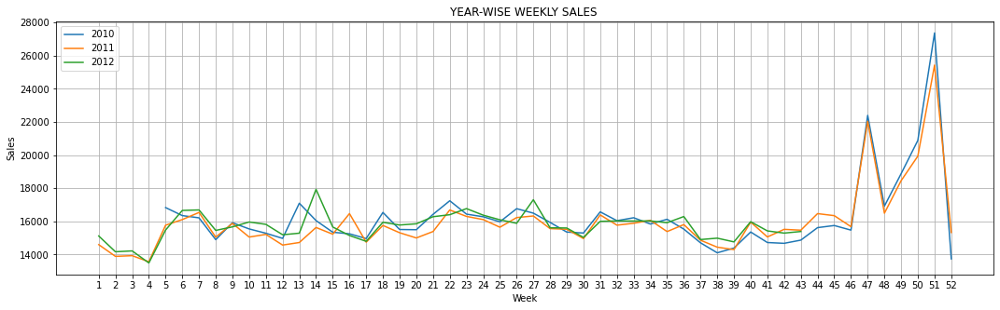

In [14]:
weekly_sales = train.groupby(['Year','Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2010 = train.loc[train['Year']==2010].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2011 = train.loc[train['Year']==2011].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2012 = train.loc[train['Year']==2012].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
plt.figure(figsize=(18, 5))

sns.lineplot(weekly_sales2010['Weekly_Sales']['mean'].index, weekly_sales2010['Weekly_Sales']['mean'].values)
sns.lineplot(weekly_sales2011['Weekly_Sales']['mean'].index, weekly_sales2011['Weekly_Sales']['mean'].values)
sns.lineplot(weekly_sales2012['Weekly_Sales']['mean'].index, weekly_sales2012['Weekly_Sales']['mean'].values)

plt.grid()
plt.xticks(np.arange(1, 53, step=1))
plt.ylabel("Sales")
plt.title("YEAR-WISE WEEKLY SALES ")
plt.legend(['2010', '2011', '2012'])
plt.show()

__Inference__ : 
*  It can be seen from the above chart that there is no trend in year-wise and no random event also happens in any year
*  It is also evident that, at the __end of the year__ there is __Huge sales__ compared to other month, which tells that _Christmas and Thanksgiving_ has __more impact on sales__ compared to Super Bowl, Labour Day
* Week _45 to 50_ have higher sales where __Christmas and Thanksgiving__ comes.

***

#### Finding Correlation

Here the Target Variable __Weekly_Sales__ is numerical nature. So we can use _Pearson Correlation coefficient or Spearman's rank correlation_ to find the Correlation between variables

#### Correlation of Numerical Features with Weekly_Sales Using HEATMAP

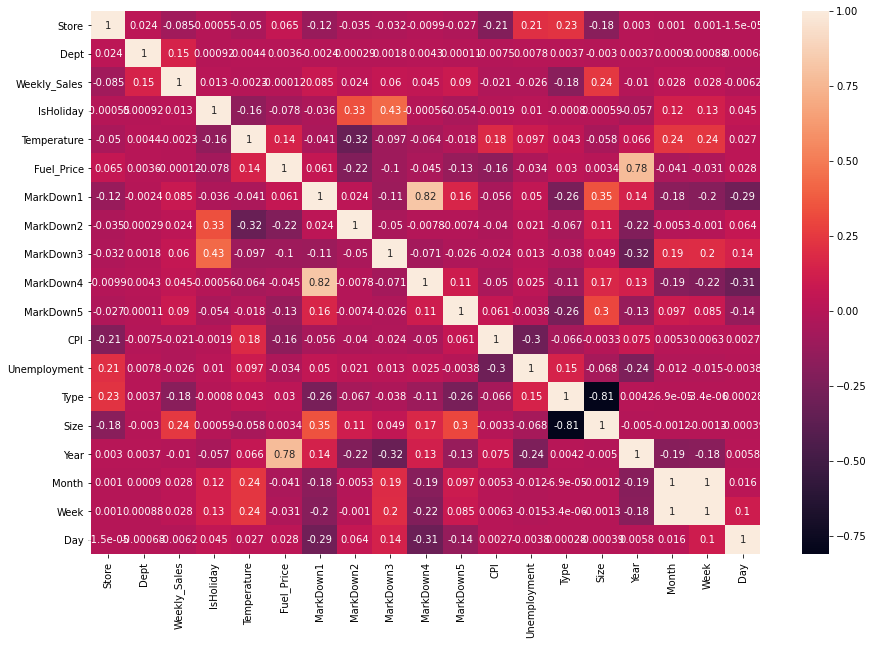

In [15]:
corr = train.corr()

fig, ax = plt.subplots(figsize = (15, 10))
corr_plot = sns.heatmap(corr, annot = True)

plt.show()

__Inference__:
*  From the correlation matrix, we observe that,
    1. MarkDown4 is highly correlated with MarkDown1 and Other two MarkDown values are also very less correlated to Target. So we can drop them.
    2. Fuel_Price is highly correlated with Year.
    3. Size is most correlated with Weekly_Sales.
    4. Finally,here we observe that none of the features are highly correlated with our target variable, Weekly_Sales.

***

In [15]:
# Let's also identify the numeric and categorical columns.
numeric_cols = train.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train.select_dtypes('object').columns.tolist()

In [16]:
print("<-----------------NUMERICAL COLUMNS------------------------------------->\n")
print(numeric_cols)
print("\n<------------------CATEGORICAL COLUMNS----------------------------------->\n")
print(categorical_cols)

<-----------------NUMERICAL COLUMNS------------------------------------->

['Store', 'Dept', 'Weekly_Sales', 'Temperature', 'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Year', 'Month', 'Week', 'Day']

<------------------CATEGORICAL COLUMNS----------------------------------->

[]


In [17]:
# Check if there is any null value in train dataframe
train.isnull().sum()

Store                0
Dept                 0
Date                 0
Weekly_Sales         0
IsHoliday            0
Temperature          0
Fuel_Price           0
MarkDown1       270889
MarkDown2       310322
MarkDown3       284479
MarkDown4       286603
MarkDown5       270138
CPI                  0
Unemployment         0
Type                 0
Size                 0
Year                 0
Month                0
Week                 0
Day                  0
dtype: int64

In [18]:
# Check if there is any null value test in dataframe
test.isnull().sum()

Store               0
Dept                0
Date                0
IsHoliday           0
Temperature         0
Fuel_Price          0
MarkDown1         149
MarkDown2       28627
MarkDown3        9829
MarkDown4       12888
MarkDown5           0
CPI             38162
Unemployment    38162
Type                0
Size                0
Year                0
Month               0
Week                0
Day                 0
dtype: int64

***

#### Impute Numerical Data

In [19]:
# Create the imputer
imputer = SimpleImputer(missing_values= np.NaN, strategy='mean')

In [20]:
# Fit the imputer to the numeric columns
imputer.fit(train[numeric_cols])

SimpleImputer()

In [21]:
#Replace all the null values
train[numeric_cols] =imputer.transform(train[numeric_cols])

In [22]:
# Check if there is any null value
train.isnull().sum()

Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
Temperature     0
Fuel_Price      0
MarkDown1       0
MarkDown2       0
MarkDown3       0
MarkDown4       0
MarkDown5       0
CPI             0
Unemployment    0
Type            0
Size            0
Year            0
Month           0
Week            0
Day             0
dtype: int64

***

### Pandas- Profiling

In [24]:
#!pip install pandas_profiling

In [71]:
import pandas_profiling as pp

In [72]:
# forming ProfileReport and save
# as output.html file
profile = pp.ProfileReport(train)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [27]:
profile.to_file("pandas_profile_output.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

#### Analysing target variable

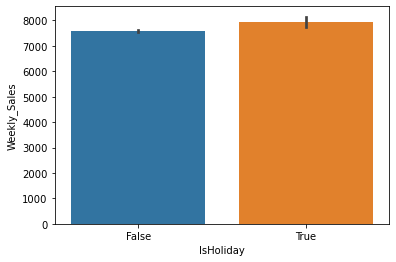

In [28]:
weekly_sales_holiday = sns.barplot(data = train,
                                   x = 'IsHoliday', y = 'Weekly_Sales',
                                   estimator = np.median)

In [29]:
train['Store'].unique()

array([ 1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12., 13.,
       14., 15., 16., 17., 18., 19., 20., 21., 22., 23., 24., 25., 26.,
       27., 28., 29., 30., 31., 32., 33., 34., 35., 36., 37., 38., 39.,
       40., 41., 42., 43., 44., 45.])

#### Analysing Size of the store for each Type

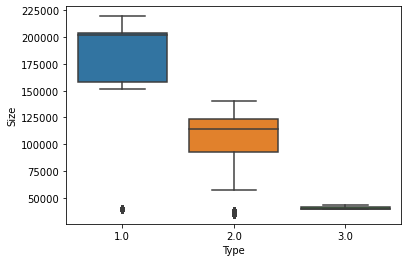

In [30]:
size_per_type = sns.boxplot(data = train, x = 'Type', y = 'Size')

__Inference:__
* Type A stores generally have larger sizes, followed by Type B, and then Type C.

#### Analysing Weekly sales based on Size of the Store

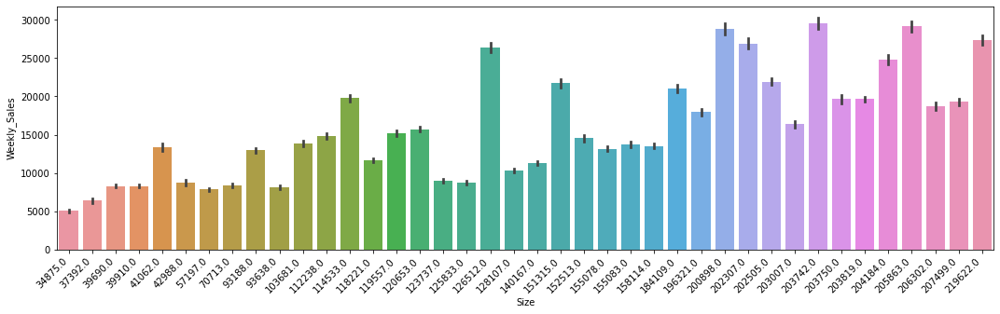

In [31]:
fig, ax = plt.subplots(figsize = (18, 4.8))

weekly_sales_per_size = sns.barplot(data = train,
                                    x = 'Size', y = 'Weekly_Sales',
                                    ax = ax
                                   )

plt.setp(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

__Inference__:

* The above plot suggests that a larger store size is associated with higher Weekly_Sales. We can infer that a typical store that has a relatively large size and is of Type A should have a proportionally high Weekly_Sales.

#### Analysing  Weekly_Sales per Store

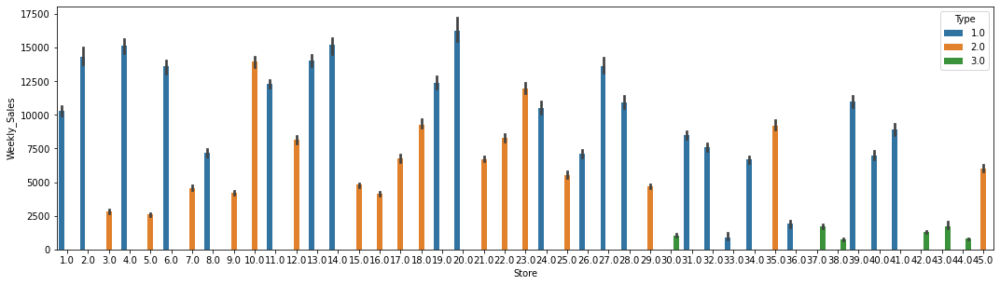

In [32]:
fig, ax = plt.subplots(figsize = (18, 4.8))

weekly_sales_per_store = sns.barplot(data = train,
                                     x = 'Store', y = 'Weekly_Sales', hue = 'Type',
                                     estimator = np.median
                                    )

__Inference:__
* The barplot suggests that different stores have different Weekly_Sales. In fact, Type A stores generally have higher Weekly_Sales, followed by Type B, and then Type C. We can confirm this below.

#### Analysing Weekly_Sales per Type

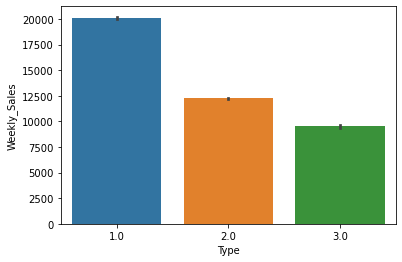

In [33]:
weekly_sales_per_type = sns.barplot(data = train, x = 'Type', y = 'Weekly_Sales')

The feature, Type, seems to be an ordinal variable in terms of Weekly_Sales. We can perform encoding taking this into account.

In [34]:
import random

In [35]:
unique_store = train['Store'].unique()

random.seed(0)
indices = random.sample(range(len(unique_store)), 6)
print(indices)

[24, 26, 2, 16, 32, 31]


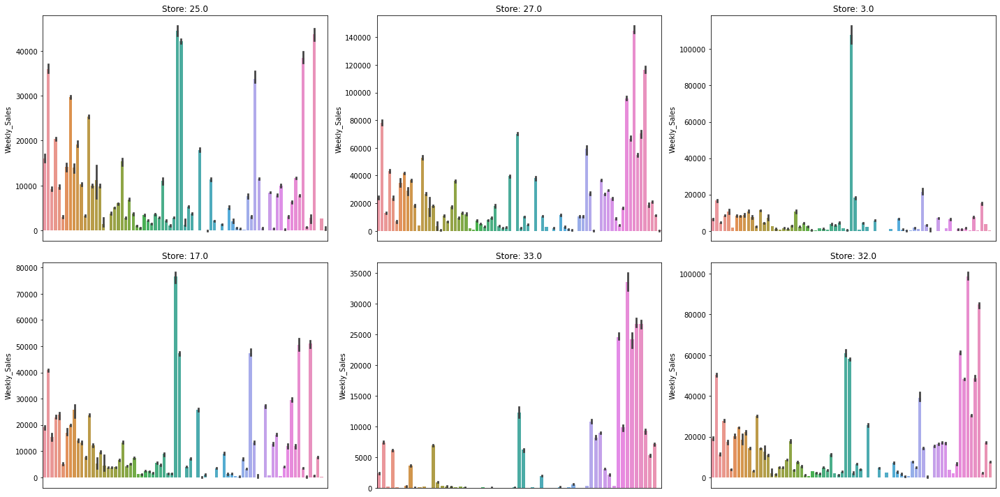

In [36]:
nrows = 2
ncols = 3

fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = (20,10))

count = 0
for i in indices:
    curr_store = unique_store[i]
    weekly_sales_per_dept = sns.barplot(data = train[train['Store'] == curr_store],
                                        x = 'Dept', y = 'Weekly_Sales',
                                        estimator = np.median,
                                        ax = ax[count // ncols, count % ncols],
                                       ).set_title('Store: ' + str(curr_store))
    ax[count // ncols, count % ncols].get_xaxis().set_visible(False)
    count += 1
    
plt.tight_layout()
plt.show()

#### Time series features

Features like Temperature, Fuel_Price, CPI, and Unemployment do not have any linear correlation with Weekly_Sales as indicated by the correlation matrix. We plot their time series to examine further.

In [37]:
ts_col = ['Weekly_Sales', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']

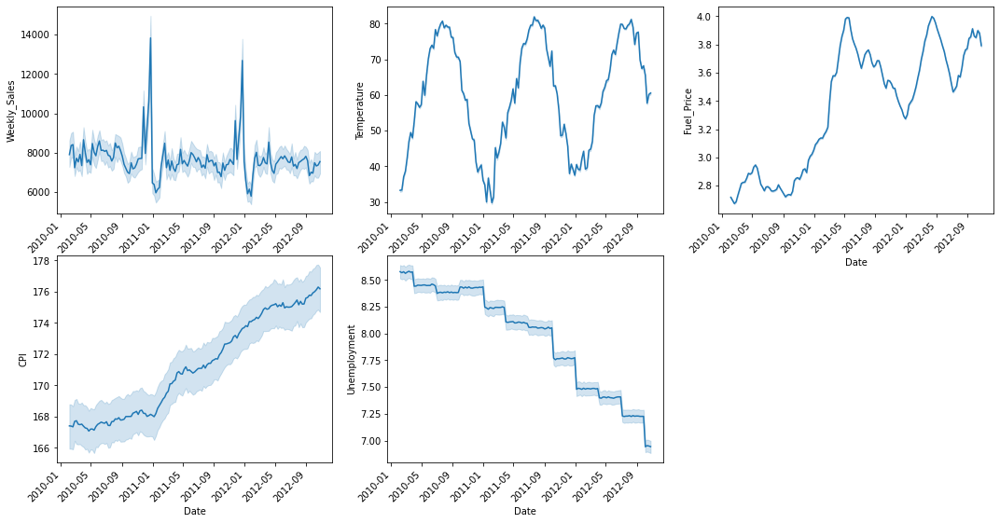

In [38]:
nrows = 2
ncols = 3

fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = (18, 9))

count = 0
for ts in ts_col:
    if count == 0:
        ts = sns.lineplot(data = train,
            x = 'Date', y = ts,
            ax = ax[count // ncols, count % ncols],
            estimator = np.median)
    else:
        ts = sns.lineplot(data = train,
        x = 'Date', y = ts,
        ax = ax[count // ncols, count % ncols],
        estimator = np.mean)
    plt.setp(ax[count // ncols, count % ncols].get_xticklabels(), rotation=45, horizontalalignment='right')
    count += 1

ax[nrows - 1, ncols - 1].set_axis_off()
plt.show()


__Inference:__
1. The economy is likely experiencing economic growth. 
2. Over time, CPI increases slightly, implying inflation. 
3. Fuel_Price rises as well. 
4. On the other hand, unemployment decreases. These effects are correlated with a strong economy.
5. For Weekly_Sales, we see peaks before the end of 2010 and 2011. 
6. However, the cyclical behavior of Temperature does not seem to correlate with that of Weekly_Sales. 

    *There does not seem to be any noticeable patterns in the other features that correspond to Weekly_Sales as well.

In [39]:
#Y_train = train['Weekly_Sales']

In [40]:
#targets = Y_train.copy()

In [41]:
#train= train.drop(['Weekly_Sales'],axis=1)

### Evaluate Algorithms

* After analysing, cleaning and preparing the data, the next step is to select the best algorithm with the optimal parameters to obtain the best results.
* This step requiers manually selecting the type of data normalization, manually selecting algorithms and tune all hyperparameters.

* Many algorithms assume normal distribution of the data, especially when features have different ranges like our case, so it is necessary to implement this step in our pipeline.

In [73]:
train.columns

Index(['Store', 'Dept', 'Date', 'Weekly_Sales', 'IsHoliday', 'Temperature',
       'Fuel_Price', 'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4',
       'MarkDown5', 'CPI', 'Unemployment', 'Type', 'Size', 'Year', 'Month',
       'Week', 'Day'],
      dtype='object')

In [74]:
train = train[train['Weekly_Sales']>0]
data = train[['Store', 'Size', 'Dept', 'Month','Type', 'Year','Week', 'Day','IsHoliday','CPI']]

In [75]:
data['Type'] = data['Type'].astype('category')
data['Type'] = data['Type'].cat.codes

### Training and Testing Set

In [76]:
X_train, X_test, y_train, y_test = train_test_split(data, train['Weekly_Sales'], test_size=0.2)

#### Normalising Data

In [77]:
t = StandardScaler()

In [78]:
t.fit(X_train)

StandardScaler()

In [79]:
train_data = t.transform(X_train)

In [80]:
test_data = t.transform(X_test)

In [81]:
test.columns

Index(['Store', 'Dept', 'Date', 'IsHoliday', 'Temperature', 'Fuel_Price',
       'MarkDown1', 'MarkDown2', 'MarkDown3', 'MarkDown4', 'MarkDown5', 'CPI',
       'Unemployment', 'Type', 'Size', 'Year', 'Month', 'Week', 'Day'],
      dtype='object')

In [82]:
data_test = test[['Store', 'Size', 'Dept', 'Month','Type', 'Year','Week', 'Day','IsHoliday','CPI']]
data_test['Type'] = data_test['Type'].astype('category')
data_test['Type'] = data_test['Type'].cat.codes

### Feature importance

In [83]:
# importing XGBRegressor
from xgboost import XGBRegressor

In [84]:
# fitting the model
model = XGBRegressor(random_state=42, n_jobs=-1, n_estimators=20, max_depth=4)

In [85]:
model.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=4, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=20, n_jobs=-1,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [86]:
#Let's turn this into a dataframe and visualize the most important features.
importance_df = pd.DataFrame({
    'feature': X_test.columns,
    'importance':model.feature_importances_
}).sort_values('importance', ascending=False)

<AxesSubplot:title={'center':'Feature Importance'}, xlabel='importance', ylabel='feature'>

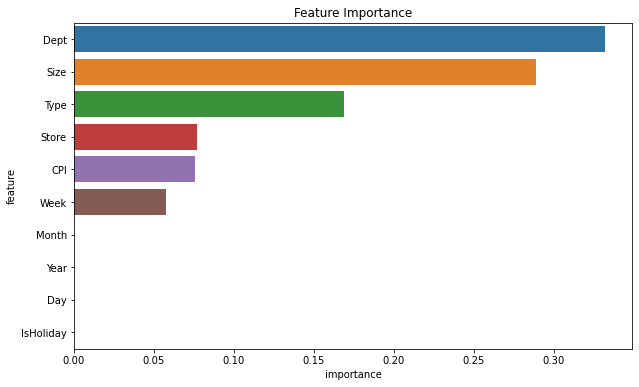

In [87]:
import seaborn as sns
plt.figure(figsize=(10,6))
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature')

### Model Training

#### Linear Regression

In [88]:
lr = LinearRegression()

In [89]:
lr.fit(X_train,y_train)

LinearRegression()

In [90]:
lr_predict = lr.predict(X_test)

In [91]:
linear_mae = mae(lr_predict,y_test)
print('MAE of Linear Regression model:',linear_mae)

MAE of Linear Regression model: 14607.577330861131


#### SVR 

In [92]:
svr = SGDRegressor(loss = 'epsilon_insensitive')

In [93]:
svr.fit(X_train,y_train)

SGDRegressor(loss='epsilon_insensitive')

In [94]:
predicted_svr = svr.predict(X_test)

In [95]:
svr_mae = mae(predicted_svr,y_test)
print('MAE of SVR model:',svr_mae)
#print('MAE of SVR model:{:.2f}'.format(svr_mae))

MAE of SVR model: 713148.9907647404


#### RidgeCV

In [96]:
ridgecv = RidgeCV()

In [97]:
ridgecv.fit(X_train,y_train)

RidgeCV(alphas=array([ 0.1,  1. , 10. ]))

In [98]:
predicted_ridgecv = ridgecv.predict(X_test)

In [99]:
ridgecv_mae = mae(predicted_ridgecv,y_test)
print('MAE of RidgeCv model:',ridgecv_mae)

MAE of RidgeCv model: 15799.056154418593


#### ElasticNet

In [100]:
elastic = ElasticNet()

In [101]:
elastic.fit(X_train,y_train)

ElasticNet()

In [102]:
predicted_elastic = elastic.predict(X_test)

In [103]:
elastic_mae = mae(predicted_elastic,y_test)
print('MAE of Elastic model:',elastic_mae)

MAE of Elastic model: 14603.572220730599


#### Random Forest

In [104]:
rf_model = RandomForestRegressor()

In [105]:
rf_model.fit(X_train,y_train)

RandomForestRegressor()

In [106]:
predicted_rf = rf_model.predict(X_test)

In [107]:
rf_mae = mae(predicted_rf,y_test)
print('MAE of RandomForest model:',rf_mae)

MAE of RandomForest model: 1279.39241531002


#### XGboost

In [108]:
xg_model =  XGBRegressor(random_state=42, n_jobs=-1, n_estimators=20, max_depth=4)

In [109]:
xg_model.fit(X_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=4, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=20, n_jobs=-1,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [110]:
predicted_xg= xg_model.predict(X_test)

In [111]:
xg_mae = mae(predicted_xg,y_test)
print('MAE of XGBoost model:',xg_mae)

MAE of XGBoost model: 6471.987714510255


In [112]:
# initialize list of lists
data = [['Linear Regression',linear_mae],
        ['SVR', svr_mae],
        ['RidgeCV',ridgecv_mae],
        ['ElasticNet',elastic_mae],
        ['RandomForest Regressor',rf_mae],
        ['XGBRegressor',xg_mae]]
 
# Create the pandas DataFrame
df = pd.DataFrame(data, columns = ['Model_Name', 'MAE score'])
# print dataframe.
df

,Model_Name,MAE score
0,Linear Regression,14607.577331
1,SVR,713148.990765
2,RidgeCV,15799.056154
3,ElasticNet,14603.572221
4,RandomForest Regressor,1279.392415
5,XGBRegressor,6471.987715


__Inference:__
* Random Forest and XGBoost Regressor models are performing well

### RandomForest performs best compared to other models